In [2]:
import numpy as np
import os
from PIL import Image

import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt

import cv2
from keras.preprocessing.image import img_to_array
from keras.models import load_model

import dlib
import glob

ModuleNotFoundError: No module named 'dlib'

In [22]:
emotion_classifier = load_model('../files/emotion_model.hdf5', compile=False)
EMOTIONS = ["Angry" ,"Disgusting","Fearful", "Happy", "Sad", "Surpring", "Neutral"]

# dlib의 얼굴 감지기 및 모델 경로
detector = dlib.get_frontal_face_detector()
predictor_path = '/Users/leehyounshu/Documents/2024D/final/files/shape_predictor_68_face_landmarks.dat'

# 얼굴 특징점 예측기 초기화
predictor = dlib.shape_predictor(predictor_path)

# 이미지 로드
image_paths = '/Users/leehyounshu/Documents/2024D/final/data/*.png' # 얼굴을 감지할 이미지의 경로
db_path_list = glob.glob(image_paths)

good = []
arr = []
title = []
for image_path in db_path_list:
    # 이미지 로드
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # 얼굴 감지
    faces = detector(gray)

    # 각 얼굴에 대한 바운딩 박스 그리기
    for face in faces:
        x1, y1 = face.left(), face.top()
        x2, y2 = face.right(), face.bottom()
        good = [[x1,y1,x2,y2]]
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

    if len(good) > 0:
        # For the largest image
        face = sorted(good, reverse=True, key=lambda x: (x[2] - x[0]) * (x[3] - x[1]))[0]
        (fX, fY, fW, fH) = face
        # Resize the image to 64x64 for neural network
        roi = gray[fY:fY + fH, fX:fX + fW]
        if roi.size == 0:
          continue
        roi = cv2.resize(roi, (64, 64))
        roi = roi.astype("float") / 255.0
        roi = img_to_array(roi)
        roi = np.expand_dims(roi, axis=0)

        # Emotion predict
        preds = emotion_classifier.predict(roi)[0]
        emotion_probability = np.max(preds)
        label = EMOTIONS[preds.argmax()]
        
        if emotion_probability > 0.75:
            arr.append((image_path, label))
            
            t = []
            for (i, (emotion, prob)) in enumerate(zip(EMOTIONS, preds)):
                text = "{}: {:.2f}%".format(emotion, prob * 100)    
                t.append(text)
            title.append(t)
        else:
            arr.append((image_path, 'not'))
            
            t = []
            for (i, (emotion, prob)) in enumerate(zip(EMOTIONS, preds)):
                text = "{}: {:.2f}%".format(emotion, prob * 100)    
                t.append(text)
            title.append(t)


1/1 [==============================] - 0s 26ms/step


In [23]:
len(arr)

1621

In [11]:
output_dir = '../labels'
for label in EMOTIONS:
    os.makedirs(os.path.join(output_dir, label), exist_ok=True)

In [26]:
for path, label in arr:
    # 이미지가 존재하는지 확인
    if os.path.exists(path):
        # 이미지 열기
        img = Image.open(path)
        
        # 저장 경로 지정
        save_path = os.path.join(output_dir, label, os.path.basename(path))
        
        # 이미지 저장
        img.save(save_path)
        
        # 분류한 이미지는 기존 폴더에서 삭제
        os.remove(path)


Saved /Users/leehyounshu/Documents/2024D/final/data/9280.png to ../labels/not/9280.png
Saved /Users/leehyounshu/Documents/2024D/final/data/1804.png to ../labels/Happy/1804.png
Saved /Users/leehyounshu/Documents/2024D/final/data/8834.png to ../labels/Happy/8834.png
Saved /Users/leehyounshu/Documents/2024D/final/data/1838.png to ../labels/Happy/1838.png
Saved /Users/leehyounshu/Documents/2024D/final/data/7285.png to ../labels/not/7285.png
Saved /Users/leehyounshu/Documents/2024D/final/data/7508.png to ../labels/Happy/7508.png
Saved /Users/leehyounshu/Documents/2024D/final/data/2302.png to ../labels/Neutral/2302.png
Saved /Users/leehyounshu/Documents/2024D/final/data/3752.png to ../labels/Happy/3752.png
Saved /Users/leehyounshu/Documents/2024D/final/data/5860.png to ../labels/not/5860.png
Saved /Users/leehyounshu/Documents/2024D/final/data/9082.png to ../labels/Neutral/9082.png
Saved /Users/leehyounshu/Documents/2024D/final/data/7905.png to ../labels/Happy/7905.png
Saved /Users/leehyounsh

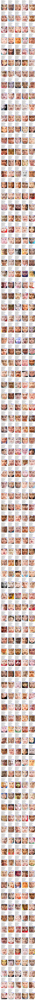

In [9]:
plt.figure(figsize=(15, 450))
for i in range(len(arr[:450])):
    plt.subplot(90, 5, i+1)
    img = Image.open(arr[i][0])
    plt.imshow(img)
    plt.title('\n'.join(title[i]), loc='left')
    title_font = {
        # 'fontsize':16,
        'color':"blue",
        'fontweight':"bold",
        'fontstyle':"italic"
    }
    plt.title(arr[i][1], loc='right', fontdict=title_font)
